In [3]:
import numpy as np
import matplotlib.pyplot as plt
from queue import PriorityQueue

     


L = 0.3  # distance between front and rear axles
dt = 0.1  # time step
NearnessThreshold = 0.1

v_settle = 1.4
# Some control inputs (example)
acceleration = 1.0  # 1 m/s^2
descretized_steering_angles = [-35,-30,-25,-15,0,15,25,30,35] 
#
state_bank = []
nodes = []
edges = []


    
class Node:
    x = 0
    y = 0
    theta = 0
    v = 0
    h = 10000
    g = 10000
    f = 10000 #make this mutable
    parent = None

    def __lt__(self, other):
        return self.f< other.f

initial_state = Node()
initial_state.x = 0
initial_state.y = 0
initial_state.theta = 0
initial_state.v = 2

def visualize(nodes, edges):
# Plot nodes
    for (x, y) in nodes:
        plt.scatter(x, y, color='blue')

    # Plot edges
    for (n1, n2) in edges:
        x_values = [n1[0], n2[0]]
        y_values = [n1[1], n2[1]]
        plt.plot(x_values, y_values, color='red')

    # Display the plot 

def move(state, dt):
    x = state.x
    y = state.y
    theta = state.theta
    v = state.v
    
    dt = dt/10
    theta_new = theta
    steering_angle = theta
    x_old = initial_state.x
    y_old = initial_state.y
    for i in range(10):
        if theta == 0:
            theta_new = 0
        else:
            theta_new = theta_new + (v / L) * np.tan(steering_angle) * dt
        x = x + v * np.cos(theta_new) * dt
        y = y + v * np.sin(theta_new) * dt
        if v < v_settle:
            v = v + acceleration * dt
        steering_angle = increment_angle(steering_angle,5)
        visualize([[x,y]],[[[x_old,y_old],[x,y]]])
        x_old = x
        y_old = y
    succ_state = Node()
    succ_state.x = x
    succ_state.y = y
    succ_state.theta = theta_new
    succ_state.v = v 
    return succ_state

def get_theta(state, steering_angle):
    x = state.x
    y = state.y
    theta = state.theta
    v = state.v
    
    theta_new = theta + (v / L) * np.tan(steering_angle) * dt
    return theta_new

def increment_angle(curr_angle,delta_angle):
    if curr_angle < 0:
        sign = -1
    else:
        sign = 1
    return sign*(np.abs(curr_angle) + np.abs(np.radians(delta_angle)))   

def generate_motion_primitives(current_state):
    generated_states = []
    for delta_state in state_bank:
        new_state = Node()
        new_state.x = current_state.x + delta_state.x
        new_state.y = current_state.y + delta_state.y
        new_state.theta = current_state.theta + delta_state.theta
        new_state.v = current_state.v + delta_state.v
        generated_states.append(new_state)
    return generated_states

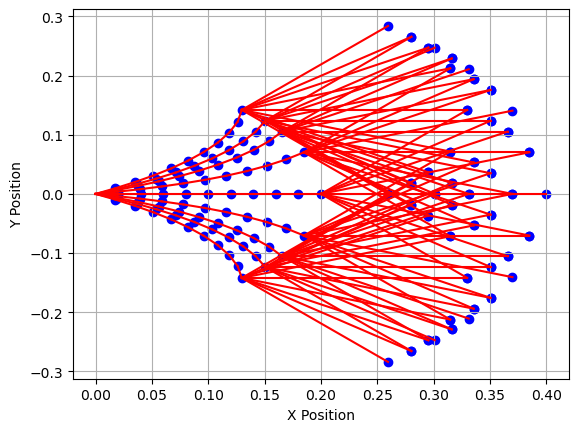

In [4]:
for steering_angle  in descretized_steering_angles:
        steering_angle = np.radians(steering_angle)  # in radians
        theta = get_theta(initial_state, steering_angle)
        temp_state = Node()
        temp_state.x = initial_state.x
        temp_state.y = initial_state.y
        temp_state.theta = theta
        temp_state.v = initial_state.v 
        new_state = move(temp_state, dt)
        state_bank.append(new_state)
        node = [new_state.x,new_state.y]
        edge = [[initial_state.x,initial_state.y],node]
        nodes.append(node)
        edges.append(edge)

for state in state_bank:
    generated_states = generate_motion_primitives(state)
    edges = []
    nodes = []
    for curr_state in generated_states:
        nodes.append([curr_state.x,curr_state.y])
        edges.append([[curr_state.x,curr_state.y],[state.x,state.y]])
        #print("curr_state = ",curr_state)
        #print("state",state)
    visualize(nodes,edges)
plt.grid(True)
plt.xlabel('X Position')
plt.ylabel('Y Position')
plt.show()

In [5]:
def getHeuristic(current_state, goal_state):
    #make this euclidean distance for now, replace with more informative heuristic 
    return np.sqrt((current_state.x - goal_state.x)**2 + (current_state.y - goal_state.y)**2)

In [6]:
def isNear(current_state, target_state):
    return (abs(current_state.x - target_state.x) < NearnessThreshold) and (abs(current_state.y - target_state.y) < NearnessThreshold )

In [7]:
goal_state = Node()
goal_state.x = 1.1
goal_state.y = -0.3


initial_state = Node()
initial_state.x = 0
initial_state.y = 0
initial_state.theta = 0
initial_state.v = 0.5
initial_state.h = getHeuristic(initial_state, goal_state)
initial_state.g = 0
initial_state.f = initial_state.g + initial_state.h

0.12971680123578314 -0.14197581507304718
0.1504639469503016 -0.12361185137320804
0.16549909657245865 -0.10534591077992617
0.18490517232157672 -0.07034916520618187
0.19999999999999998 0.0
0.18490517232157672 0.07034916520618187
0.16549909657245865 0.10534591077992617
0.1504639469503016 0.12361185137320804
0.12971680123578314 0.14197581507304718
0.3146219735573599 -0.21232498027922905
0.3353691192718783 -0.1939610165793899
0.35040426889403536 -0.17569507598610803
0.36981034464315343 -0.14069833041236374
0.3849051723215767 -0.07034916520618187
0.36981034464315343 0.0
0.35040426889403536 0.0349967455737443
0.3353691192718783 0.053262686167026174
0.3146219735573599 0.07162664986686532
0.3297168012357831 -0.14197581507304718
0.3504639469503016 -0.12361185137320804
0.3654990965724586 -0.10534591077992617
0.3849051723215767 -0.07034916520618187
0.39999999999999997 0.0
0.3849051723215767 0.07034916520618187
0.3654990965724586 0.10534591077992617
0.3504639469503016 0.12361185137320804
0.32971680

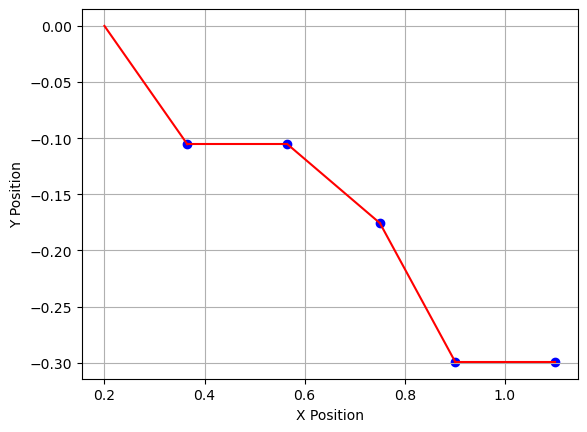

In [8]:
nodes = []
edges = []
visited = dict()
visited[(int(initial_state.x), int(initial_state.y))] = initial_state.g
my_queue = PriorityQueue()
my_state = initial_state
while not isNear(my_state, goal_state):
    succ_states = generate_motion_primitives(my_state)
    print(succ_states[0])
    for succ_state in succ_states:
        if (succ_state.x, succ_state.y) in visited.keys():
            if visited[(int(succ_state.x), int(succ_state.y))] < my_state.g + 1:
                continue
        else:
            succ_state.g = my_state.g + 1
            succ_state.h = getHeuristic(succ_state, goal_state)
            succ_state.f = succ_state.g + succ_state.h
            succ_state.parent = my_state
            visited[(int(succ_state.x), int(succ_state.y))] = succ_state.g
            print(succ_state.x ,succ_state.y)
            my_queue.put(succ_state)
            
    new_state = my_queue.get()
    my_state = new_state

#back track
iter_state = my_state
path = []
while iter_state.x != initial_state.x and iter_state.y != initial_state.y:
    print("k")
    path.append(iter_state)
    nodes.append([iter_state.x,iter_state.y])
    edges.append([[iter_state.x,iter_state.y],[iter_state.parent.x, iter_state.parent.y]])
    iter_state = iter_state.parent

visualize(nodes,edges)
plt.grid(True)
plt.xlabel('X Position')
plt.ylabel('Y Position')
plt.show()
        
        

    

In [ ]:
print(nodes)